In [19]:
%load_ext autoreload
import ddsp
from pathlib import Path
import os
import torch
import yaml
import matplotlib.pyplot as plt
import IPython.display as ipd
plt.rcParams['figure.figsize']= (18, 7.5*3/2)
plt.rcParams['figure.dpi']= 300

os.getcwd()
os.chdir('/home/hugo/lab/ddsp_pytorch/')

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [20]:
def plot_interpolator(model, output):
    plt.clf()
    ax = plt.subplot(231)
    model.harmonic_synth.plot(ax, output['harmonic_ctrls'])
    
    ax = plt.subplot(232)
    model.noise_synth.plot(ax, output['noise_ctrls'])
    
    ax = plt.subplot(233)
    stft = ddsp.multiscale_fft(output['signal'].reshape(-1), [2048], 0.75)[0]
    stft = ddsp.utils.tonp(stft)
    stft = ddsp.utils.stft_to_mel(stft, 
                                 model.config1['preprocess']['sample_rate'], 
                                     2048, 512)
    ax.set_title('spectrogram')
    ddsp.utils.plot_spec(stft, ax)
    
    ax = plt.subplot(234)
    plt.plot(ddsp.utils.hz_to_midi(output['f0'].view(-1)))
    ax.set_title('f0 (midi)')
    ax.set_ylim([16, 120])
    ax.set_xlabel('frames')
    
    ax = plt.subplot(235)
    plt.plot(output['loudness'].view(-1))
    ax.set_title('loudness')
    ax.set_xlabel('frames')
    
    ax = plt.subplot(236)
    if isinstance(output['alpha'], int):
        output['alpha'] = torch.ones_like(output['loudness'])*output['alpha']
    plt.plot(output['alpha'].view(-1))
    ax.set_title('alpha')
             
    plt.tight_layout()
    return plt.gcf()

In [21]:
def plot_interpolator(model, output1, output2, outputinterp):
    plt.clf()
    ax = plt.subplot(331)
    model.harmonic_synth.plot(ax, output1['harmonic_ctrls'])
    
    ax = plt.subplot(332)
    model.noise_synth.plot(ax, output1['noise_ctrls'])
    
    ax = plt.subplot(333)
    stft = ddsp.multiscale_fft(output1['signal'].reshape(-1), [2048], 0.75)[0]
    stft = ddsp.utils.tonp(stft)
    stft = ddsp.utils.stft_to_mel(stft, 
                                 model.config1['preprocess']['sample_rate'], 
                                     2048, 512)
    ax.set_title('spectrogram')
    ddsp.utils.plot_spec(stft, ax)
    
    
    ax = plt.subplot(334)
    model.harmonic_synth.plot(ax, output2['harmonic_ctrls'])
    
    ax = plt.subplot(335)
    model.noise_synth.plot(ax, output2['noise_ctrls'])
    
    ax = plt.subplot(336)
    stft = ddsp.multiscale_fft(output2['signal'].reshape(-1), [2048], 0.75)[0]
    stft = ddsp.utils.tonp(stft)
    stft = ddsp.utils.stft_to_mel(stft, 
                                 model.config1['preprocess']['sample_rate'], 
                                     2048, 512)
    ax.set_title('spectrogram')
    ddsp.utils.plot_spec(stft, ax)
    
    ax = plt.subplot(337)
    model.harmonic_synth.plot(ax, outputinterp['harmonic_ctrls'])
    
    ax = plt.subplot(338)
    model.noise_synth.plot(ax, outputinterp['noise_ctrls'])
    
    ax = plt.subplot(339)
    stft = ddsp.multiscale_fft(outputinterp['signal'].reshape(-1), [2048], 0.75)[0]
    stft = ddsp.utils.tonp(stft)
    stft = ddsp.utils.stft_to_mel(stft, 
                                 model.config1['preprocess']['sample_rate'], 
                                     2048, 512)
    ax.set_title('spectrogram')
    ddsp.utils.plot_spec(stft, ax)
    
#     ax = plt.subplot(234)
#     plt.plot(ddsp.utils.hz_to_midi(output['f0'].view(-1)))
#     ax.set_title('f0 (midi)')
#     ax.set_ylim([16, 120])
#     ax.set_xlabel('frames')
    
#     ax = plt.subplot(235)
#     plt.plot(output['loudness'].view(-1))
#     ax.set_title('loudness')
#     ax.set_xlabel('frames')
    
#     ax = plt.subplot(236)
#     if isinstance(output['alpha'], int):
#         output['alpha'] = torch.ones_like(output['loudness'])*output['alpha']
#     plt.plot(output['alpha'].view(-1))
#     ax.set_title('alpha')
             
    plt.tight_layout()
    return plt.gcf()

def play_output(output):
    audio = output['signal']
    import IPython.display as ipd
    return ipd.Audio(audio.reshape(-1), rate=48000) # load a NumPy array

In [22]:
def loader(config):
    config['train']['batch'] = 6
    dm = ddsp.data.Datamodule(config)
    dm.setup()

    train_loader = dm.train_dataloader(shuffle=False)
    val_loader = dm.val_dataloader()
    return train_loader

def flatten_batch(b, key: str, batch: bool):
    if not batch:
        return torch.cat([a for a in b[key]], dim=0).unsqueeze(0)
    else:
        return b[key]

def batch_cat(d: dict):
    for k, v in d.items():
        if isinstance(v, torch.Tensor):
            print(v.shape)
            if v.ndim > 2:
                d[k] = torch.cat([a for a in v], dim=0).unsqueeze(0)

        if isinstance(v, list):
            d[k] = torch.cat(v, dim=0)
        if isinstance(v, dict):
            d[k] =  batch_cat(v)
    return d

def mean(z):
    return z.mean(dim=0, keepdim=True).mean(dim=1, keepdim=True)

def max(z):
    return z.max(dim=0, keepdim=True)[0].max(dim=1, keepdim=True)[0]

def repeat(z, p):
    for d in (0, 1):
        z = torch.repeat_interleave(z, p.shape[d], dim=d)
    return z

def repeat_if_necessary(z1, z2, pitch, mmax):
    #take the mean of the sequences
    if mmax is not None:
        if mmax == "mean":
            z1 = mean(z1)
            z2 = mean(z2)
        else:
            z1 = max(z1)
            z2 = max(z2)

        #restore the original shape by repeating the mean
        z1 = repeat(z1, pitch)
        z2 = repeat(z2, pitch)
    else:
        
        if not pitch.shape[:-1] == z1.shape[:-1]:
            # cut off the last one to match lenghts
            z1 = z1[:, :-1, :]
        if not pitch.shape[:-1] == z2.shape[:-1]:
            z2 = z2[:, :-1, :]

    return z1, z2
    

def z_interpolator(mconfig, zconfig1, zconfig2, dconfig,
                   pm=1, ladd=0, calpha=None, batch=True, mmax='mean'):
    
    model = ddsp.train.load_model(mconfig)
    model = ddsp.export.load_model_state_dict(model, mconfig)
    model.config1 = mconfig
    model.eval()
    
    mloader = loader(mconfig)
    dloader = loader(dconfig)
    loader1 = loader(zconfig1)
    loader2 = loader(zconfig2)
    
    bm = next(iter(mloader))
    b1 = next(iter(loader1))
    b2 = next(iter(loader2))
    bd = next(iter(dloader))
    
    # get pitch and loudness
    pitch = flatten_batch(bd, 'f0', batch)
    loudness = flatten_batch(bd, 'loudness', batch)
    
    b1['mfcc'] = flatten_batch(b1, 'mfcc', batch)
    b2['mfcc'] = flatten_batch(b2, 'mfcc', batch)
    
    # get z vector sequences
    with torch.no_grad():
        z1 = model.encode(b1['mfcc'])
        z2 = model.encode(b2['mfcc'])
    
    z1, z2 = repeat_if_necessary(z1, z2, pitch, mmax) 
    
    # normlize loudness to match distro
    loudness = ddsp.export.normalize_loudness(mconfig, loudness)
    
    # add offset to loudness
    loudness = loudness + ladd
    print(loudness.mean(), loudness.std())
    print(pitch.mean(), pitch.std())
    print(z1.mean(), z1.std())
    print(z2.mean(), z2.std())

    # build a linear ramp from 0 to 1 as alpha
    n_bins = pitch.shape[1] * pitch.shape[0]
    alpha =  1 - 1 / n_bins * torch.arange(n_bins)
    alpha = alpha.unsqueeze(0).unsqueeze(-1)

    # if alpha is constant, keep it constant
    if calpha is not None: 
        alpha = calpha
    if isinstance(alpha, torch.Tensor):
        # alpha = torch.stack([alpha for _ in range(len(pitch))]).squeeze(1)
        alpha = alpha.view(pitch.shape)
        print(alpha.shape)
        
    print(pitch.shape)
    print(z1.shape)
    
    # interpolate between zs
    z = ddsp.utils.lin_interp(z1, z2, alpha)

    with torch.no_grad():
        output = model.decode(z, pitch*pm, loudness)
        
#         b1 = batch_cat(b1)
#         b1['loudness'] = ddsp.export.normalize_loudness(zconfig1, b1['loudness']) + ladd
#         output = model(b1)
        
        if batch:
            output = batch_cat(output)
        output['alpha'] = alpha
    return model, output

In [23]:
configs = {
    p.parent.name: ddsp.export.load_config(p)
        for p in Path('./runs').glob('**/config.yaml')
}
configs['rainbow'] = ddsp.export.load_config('./configs/rainbow.yaml')
configs['me'] = ddsp.export.load_config('./configs/me.yaml')
configs['string'] = ddsp.export.load_config('./configs/string.yaml')
configs['reed'] = ddsp.export.load_config('./configs/reed.yaml')

list(configs.keys())


['bass_synthetic_012',
 'ae-mdb-solosv1',
 'debug',
 'ae-multi-zdim=16',
 'violin-interp-v1',
 'violin-omg',
 'ae-mdb-solos',
 'violin-gru',
 'flute-dcdr',
 'tenor-dcdr',
 'gru-AE-zdim=16',
 'guitar_electronic_001',
 'clarinet-dcdr',
 'clarinet-dcdr copy',
 'tenor-dcdr-v2',
 'debug copy',
 'flute_synthetic_002',
 'flute-omg',
 'violin-gruv1',
 'flute-v0',
 'ae-multi-zdim=32',
 'guitar_acoustic_016',
 'string_reed_mfcc-autoencoder',
 'keyboard_acoustic_016',
 'bass-interp-v1',
 'violin-dcdr copy',
 'autoencdr',
 'reed_acoustic_011',
 'violin-dcdr',
 'string_acoustic_080',
 'violin-interp-v0',
 'bass-interp-v0',
 'rainbow',
 'me',
 'string',
 'reed']

tensor(4.5325) tensor(0.3628)
tensor(543.3435) tensor(189.6916)
tensor(2.0023) tensor(7.6698)
tensor(2.0165) tensor(8.2057)
torch.Size([1, 2250, 1])
torch.Size([1, 2250, 16])
tensor(4.5325) tensor(0.3628)
tensor(543.3435) tensor(189.6916)
tensor(2.0023) tensor(7.6698)
tensor(2.0165) tensor(8.2057)
torch.Size([1, 2250, 1])
torch.Size([1, 2250, 16])
tensor(4.5325) tensor(0.3628)
tensor(543.3435) tensor(189.6916)
tensor(2.0023) tensor(7.6698)
tensor(2.0165) tensor(8.2057)
torch.Size([1, 2250, 1])
torch.Size([1, 2250, 1])
torch.Size([1, 2250, 16])


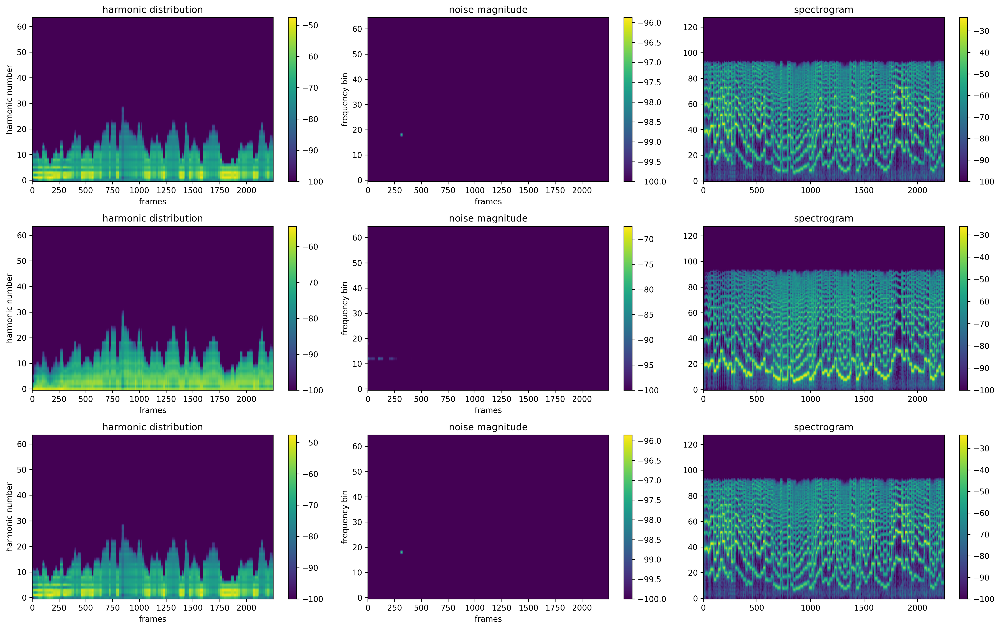

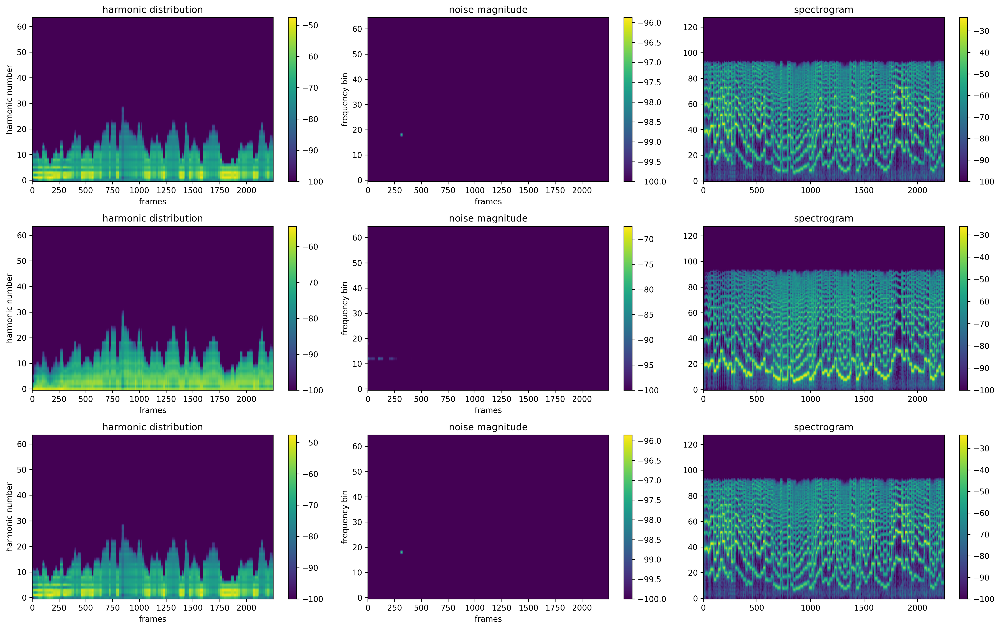

In [24]:
mconfig = configs['gru-AE-zdim=16']#
zconfig1 = configs['violin-dcdr']
zconfig2 = configs['clarinet-dcdr']
dconfig = configs['violin-dcdr']

model, output1      = z_interpolator(mconfig, zconfig1, zconfig2, dconfig,
                               pm=1, ladd=1, calpha=1, batch=False, mmax=None)
model, output2      = z_interpolator(mconfig, zconfig1, zconfig2, dconfig,
                               pm=1, ladd=1, calpha=0, batch=False, mmax=None)
model, outputinterp = z_interpolator(mconfig, zconfig1, zconfig2, dconfig,
                               pm=1, ladd=1, calpha=None, batch=False, mmax=None)

plot_interpolator(model, output1, output2, outputinterp)

In [25]:
play_output(output1)

In [26]:
play_output(output2)

In [27]:
play_output(outputinterp)

tensor(1.4341) tensor(0.7047)
tensor(152.6385) tensor(55.3979)
tensor(-0.9790) tensor(3.4931)
tensor(-1.2662) tensor(4.5156)
torch.Size([1, 2250, 1])
torch.Size([1, 2250, 16])
tensor(1.4341) tensor(0.7047)
tensor(152.6385) tensor(55.3979)
tensor(-0.9790) tensor(3.4931)
tensor(-1.2662) tensor(4.5156)
torch.Size([1, 2250, 1])
torch.Size([1, 2250, 16])
tensor(1.4341) tensor(0.7047)
tensor(152.6385) tensor(55.3979)
tensor(-0.9790) tensor(3.4931)
tensor(-1.2662) tensor(4.5156)
torch.Size([1, 2250, 1])
torch.Size([1, 2250, 1])
torch.Size([1, 2250, 16])


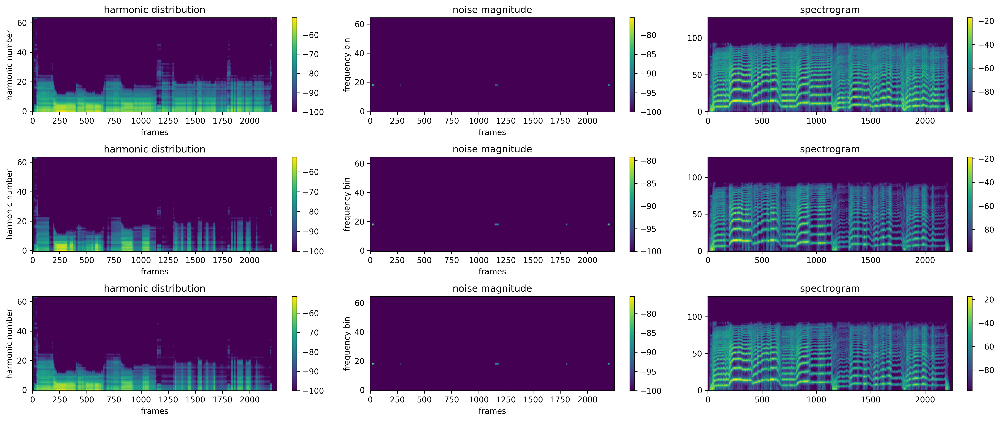

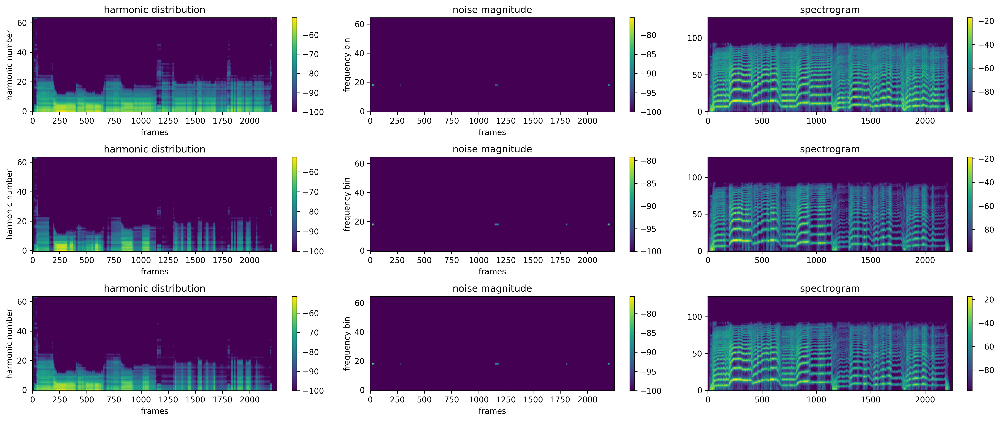

In [37]:
mconfig = configs['string_reed_mfcc-autoencoder'] #['gru-AE-zdim=16']#
zconfig1 = configs['reed']
zconfig2 = configs['string']
dconfig = configs['rainbow']

model, output1      = z_interpolator(mconfig, zconfig1, zconfig2, dconfig,
                               pm=2, ladd=0, calpha=1, batch=False, mmax="mean")
model, output2      = z_interpolator(mconfig, zconfig1, zconfig2, dconfig,
                               pm=2, ladd=0, calpha=0, batch=False, mmax="mean")
model, outputinterp = z_interpolator(mconfig, zconfig1, zconfig2, dconfig,
                               pm=2, ladd=0, calpha=None, batch=False, mmax="mean")

plot_interpolator(model, output1, output2, outputinterp)

In [35]:
play_output(output1)

In [36]:
play_output(output2)

In [37]:
play_output(outputinterp)

tensor(-11.2998) tensor(1.4353)
tensor(152.6385) tensor(55.3979)
tensor(-0.9337) tensor(2.9121)
tensor(-1.0216) tensor(3.7884)
torch.Size([6, 375, 1])
torch.Size([6, 375, 16])
torch.Size([6, 375, 1])
torch.Size([6, 375, 1])
torch.Size([6, 192000, 1])
torch.Size([6, 192000, 1])
torch.Size([6, 192000, 1])
torch.Size([6, 375, 65])
torch.Size([6, 375, 1])
torch.Size([6, 375, 64])
torch.Size([6, 375, 1])
torch.Size([6, 375, 16])


/home/hugo/lab/ddsp_pytorch/ddsp/utils.py:45: RuntimeWarning: divide by zero encountered in log2
  return 12 * np.log2(freqs / 440) + 69


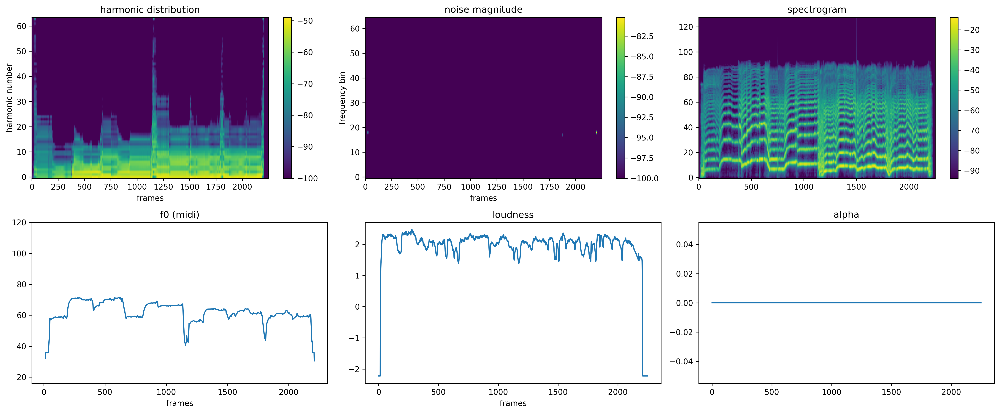

In [10]:
play_output(output2)

play_output(outputinterp)mconfig = configs['string_reed_mfcc-autoencoder'] #['gru-AE-zdim=16']#
zconfig1 = configs['reed']
zconfig2 = configs['string']
dconfig = configs['rainbow']

model, output = z_interpolator(mconfig, zconfig1, zconfig2, dconfig,
                               pm=2, ladd=1, calpha=0, mmax="mean")
plot_interpolator(model, output)
audio = output['signal']
ipd.Audio(audio.reshape(-1), rate=48000) # load a NumPy array

In [54]:
import pandas as pd
import plotly.express as px
def dim_reduce(emb, labels, n_components=3, method='umap', title=''):
    """
    dimensionality reduction for visualization!
    returns a plotly figure with a 2d or 3d dim reduction of ur data
    parameters:
        emb (np.ndarray): the samples to be reduced with shape (samples, features)
        labels (list): list of labels for embedding with shape (samples)
        method (str): umap, tsne, or pca
        title (str): title for ur figure
    returns:    
        fig (plotly figure): 
    """
    if method == 'umap':
        import umap
        reducer = umap.UMAP(n_components=n_components)
    elif method == 'tsne':
        from sklearn.manifold import TSNE
        reducer = TSNE(n_components=n_components)
    elif method == 'pca':
        from sklearn.decomposition import PCA
        reducer = PCA(n_components=n_components)
    else:
        raise ValueError(f'dunno how to do {method}')
 
    proj = reducer.fit_transform(emb)

    if n_components == 2:
        df = pd.DataFrame(dict(
            x=proj[:, 0],
            y=proj[:, 1],
            instrument=labels
        ))
        fig = px.scatter(df, x='x', y='y', color='instrument',
                        title=title)

    elif n_components == 3:
        df = pd.DataFrame(dict(
            x=proj[:, 0],
            y=proj[:, 1],
            z=proj[:, 2],
            instrument=labels
        ))
        fig = px.scatter_3d(df, x='x', y='y', z='z',
                        color='instrument',
                        title=title)

    else:
        raise ValueError("cant plot more than 3 components")

    fig.update_traces(marker=dict(size=6,
                                  line=dict(width=1,
                                            color='DarkSlateGrey')),
                      selector=dict(mode='markers'))

    return fig

In [58]:
def get_mfccs(confs, config_labels):
    labels = []
    mfccs = []
    for label, config in zip(config_labels, confs):
        dm = ddsp.data.Datamodule(config)
        dm.setup()
        mfcc = [torch.tensor(m) for m in dm.train_data.mfccs]
#         mfcc = dm.val_data.mfccs
        mfccs.extend(mfcc)
        labels.extend([label for _ in range(len(mfcc))])#mfcc[0].shape[0]*
    
    mfccs = torch.stack(mfccs)
    return labels, mfccs
    

def z_space(mconfig, zconfs, zconflabels):
    labels, mfccs = get_mfccs(cnfs, ls)

    model = ddsp.train.load_model(mconfig)
    model = ddsp.export.load_model_state_dict(model, mconfig)
    model.config1 = mconfig
    model.eval()

    with torch.no_grad():
        Z = model.encode(mfccs)

    Z = Z.mean(dim=1)
#     Z = Z.view(-1, 16)
    print(Z.shape)
    fig = dim_reduce(Z, labels, n_components=2, method='tsne', title='violin-clarinet')
    return fig

In [59]:
mconfig = configs['string_reed_mfcc-autoencoder']
cnfs = [configs['reed'], configs['string']]
ls = ['reed', 'string']

fig = z_space(mconfig, cnfs, ls)
fig.show()

torch.Size([263, 16])


In [60]:
mconfig = configs['gru-AE-zdim=16']
cnfs = [configs['violin-dcdr'], configs['clarinet-dcdr']]
ls = ['violin', 'clarinet']

fig = z_space(mconfig, cnfs, ls)
fig.show()

torch.Size([399, 16])


In [34]:
import numpy as np
import plotly.io as pio
pio.show(
{
    'data': [{'hovertemplate': 'instrument=violin<br>x=%{x}<br>y=%{y}<extra></extra>',
              'legendgroup': 'violin',
              'marker': {'color': '#636efa',
                         'line': {'color': 'DarkSlateGrey', 'width': 1},
                         'size': 6,
                         'symbol': 'circle'},
              'mode': 'markers',
              'name': 'violin',
              'orientation': 'v',
              'showlegend': True,
              'type': 'scatter',
              'x': np.array([ 9.684051 ,  9.2262535, 10.8221655,  9.636728 , 11.442936 , 10.490052 ,
                           9.815935 , 10.804094 , 11.0901   , 11.244507 ,  9.760758 , 10.698195 ,
                          -5.4649644,  9.365348 , 10.08127  , 10.988323 , 11.074785 ,  9.7335205,
                          10.769681 , 11.561311 , 11.579442 , 10.393617 ,  9.434823 , 10.542419 ,
                           9.692309 , 11.196678 , 10.129797 ,  9.4422865, 10.350476 , 10.793753 ,
                          11.224599 ,  9.662854 , 10.96487  , 10.469962 , 10.206858 , 11.185769 ,
                          11.675632 , 11.078627 ,  9.494448 , 10.195695 , 11.412629 , 10.2088585,
                          -3.170959 , 11.006287 , 10.174648 , 10.044086 , 10.266451 ,  9.336848 ,
                          10.051295 , 10.307536 , 11.384602 ,  9.917163 , 11.544943 ,  9.526117 ,
                          11.511717 , 10.962804 ,  9.977127 , 11.212654 , 10.027875 , 10.254749 ,
                          11.244984 , 11.55078  , 10.944649 , 11.256959 ,  9.945413 , 10.892117 ,
                          11.107586 , 11.465966 , 10.030687 , 11.612566 , 11.208991 ,  9.948693 ,
                          11.249429 , -2.4636426, 10.886739 , 10.857497 , 11.137565 , 11.682461 ,
                          11.022757 ,  9.853978 , -5.314812 , -5.698208 , 10.018424 ,  9.318373 ,
                           9.770217 , 11.058936 , 11.067935 ,  9.996843 ,  9.673574 , 10.610812 ,
                          10.027503 , 10.805911 , 10.323956 , 10.744675 , 10.243821 , -5.3647947,
                          11.397132 , 10.307993 , 10.284036 ,  9.972843 ], dtype=np.float32),
              'xaxis': 'x',
              'y': np.array([ 9.357688 , 12.433931 ,  8.846166 , 11.953659 ,  7.3919497,  8.087826 ,
                           9.433507 , 10.640505 , 10.574816 ,  8.429726 , 10.824421 , 11.33972  ,
                           3.3512504, 12.584503 ,  8.84912  ,  8.754168 ,  8.644147 ,  9.250592 ,
                           9.487181 ,  8.84187  ,  8.181671 ,  9.582442 , 12.46684  ,  9.675305 ,
                           9.30065  , 10.509803 ,  9.271267 , 12.430526 ,  8.312327 ,  8.253645 ,
                          10.225518 , 12.013523 ,  9.002994 , 11.756253 , 11.600745 ,  7.244271 ,
                           8.294572 , 10.829692 , 12.453321 , 11.9683   ,  8.90063  , 10.070334 ,
                           2.3340998,  7.163324 ,  9.266022 , 11.814847 , 11.827737 , 12.061071 ,
                          12.103674 ,  9.139746 ,  7.330878 , 11.7426605,  8.192209 , 12.251275 ,
                           8.140713 ,  9.762297 , 11.29127  ,  9.6372795, 11.381823 ,  9.125659 ,
                           9.033561 ,  8.82545  , 10.674389 ,  8.29096  , 12.136645 ,  8.851363 ,
                          10.230106 ,  8.335273 ,  9.568141 ,  7.928191 , 10.366431 ,  9.930278 ,
                           7.227129 ,  4.2041745,  7.177401 , 10.824369 ,  7.4614654,  7.726464 ,
                           8.085662 , 11.1295   ,  3.5407984,  3.232198 ,  8.9489355, 12.296671 ,
                           9.252989 ,  7.335252 ,  7.3719096, 10.745737 , 11.923674 , 10.539275 ,
                           9.494111 , 10.55011  , 10.361868 ,  9.707259 , 11.739778 ,  3.4756992,
                          10.4310255, 11.745147 ,  8.357073 , 11.982911 ], dtype=np.float32),
              'yaxis': 'y'},
             {'hovertemplate': 'instrument=clarinet<br>x=%{x}<br>y=%{y}<extra></extra>',
              'legendgroup': 'clarinet',
              'marker': {'color': '#EF553B',
                         'line': {'color': 'DarkSlateGrey', 'width': 1},
                         'size': 6,
                         'symbol': 'circle'},
              'mode': 'markers',
              'name': 'clarinet',
              'orientation': 'v',
              'showlegend': True,
              'type': 'scatter',
              'x': np.array([-3.2963161, -3.204725 , -4.5789056, -4.3162937, -4.292314 , -4.3116198,
                          -5.0402246, -4.3329935, -3.8478298, -3.6432605, -2.6523285, -5.4626045,
                          -4.1866546, -6.1933184, -5.9657354, -3.3428388, -2.482718 , -5.1585784,
                          -6.278494 , -4.824331 , -3.1961167, -3.6924465, -3.5989125, -4.066017 ,
                          -2.6149542, -2.2989676, -2.3750107, -4.978723 , -5.5147805, -4.652742 ,
                          -3.7227829, -5.7224064, -5.620535 , -4.287052 , -4.647834 , -4.4425654,
                          -6.261689 , -2.5323539, -4.072317 , -6.2383666, -4.3284993, -3.3639536,
                          -5.4555993, -2.270841 , -2.5469239, -2.3698688, -4.459225 , -3.9573576,
                          -4.7948847, -5.849966 , -5.009106 , -2.2797058, -4.236302 , -3.2328994,
                          -3.1160765, -3.0999858, -4.803743 , -3.6176817, -4.276534 , -4.1637135,
                          -6.324392 , -6.3129272, -3.3223257, -3.5644825, -3.2116392, -4.128469 ,
                          -4.0021415, -5.577438 , -3.2292604, -4.529099 , -5.9975653, -4.12012  ,
                          -5.940117 , -5.659213 , -3.388691 , -4.889312 , -5.09039  , -4.2644134,
                          -4.904194 , -2.9409542, -4.2705526, -4.5247364, -2.28421  , -5.614018 ,
                          -3.9306853, -4.2464643, -3.7029526, -3.1605637, -3.7559545, -4.5293097,
                          -3.7436612, -3.3855116, -4.717463 , -3.3038745, -3.6454325, -5.047918 ,
                          -5.1153193, -3.1678154, -3.2209437, -6.2032294], dtype=np.float32),
              'xaxis': 'x',
              'y': np.array([2.5925438 , 4.57266   , 1.7420119 , 0.7397279 , 4.4411016 , 3.2500217 ,
                          3.38542   , 2.9333997 , 4.328472  , 4.4995613 , 4.3980775 , 2.737238  ,
                          1.1498486 , 0.6944396 , 0.9482043 , 1.3107516 , 4.601658  , 1.6601928 ,
                          0.8102063 , 3.4225438 , 1.6377935 , 3.3326874 , 4.535865  , 2.3713286 ,
                          3.8639238 , 4.0595975 , 4.346274  , 3.132272  , 1.3982781 , 4.2274337 ,
                          4.4848213 , 1.049709  , 3.1047425 , 3.8248897 , 3.15856   , 3.466292  ,
                          0.797455  , 3.9834306 , 0.8975405 , 0.8725545 , 0.89253116, 2.3847785 ,
                          2.9353871 , 4.4280066 , 4.038753  , 4.4629807 , 2.7544105 , 2.5932434 ,
                          3.0107148 , 0.87097526, 3.53988   , 4.4024076 , 2.5583858 , 2.4407306 ,
                          1.525547  , 4.638798  , 2.9025142 , 1.12589   , 3.2398133 , 0.868645  ,
                          1.0173765 , 0.8573279 , 1.3847668 , 2.7567847 , 1.6655239 , 0.9465705 ,
                          4.4976497 , 2.9655528 , 1.8143816 , 0.9131509 , 0.8603029 , 3.0416381 ,
                          1.0362291 , 0.9891946 , 1.8041497 , 4.024115  , 3.7344942 , 1.7709192 ,
                          1.9882773 , 3.7079394 , 0.71158177, 1.2376004 , 4.264125  , 3.3645492 ,
                          4.5056424 , 0.80250895, 1.086551  , 4.45979   , 2.0052264 , 2.5925598 ,
                          1.972989  , 4.4451976 , 4.1657624 , 4.5024004 , 2.038481  , 1.4733711 ,
                          1.7296193 , 1.5470595 , 4.36059   , 1.0284485 ], dtype=np.float32),
              'yaxis': 'y'}],
    'layout': {'legend': {'title': {'text': 'instrument'}, 'tracegroupgap': 0},
               'margin': {'t': 60},
#                'template': '...',
               'xaxis': {'anchor': 'y', 'domain': [0.0, 1.0], 'title': {'text': 'x'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text': 'y'}}}
})